In [1]:
import pandas as pd
import scanpy as sc 
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import rcParams
import os,re


In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings('ignore', 'No data for colormapping provided via', UserWarning)

In [5]:
os.chdir("/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_h5")

In [6]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 100

In [8]:
 
print("Sart")
# ````````````````````````````````````````````````````````````````
adata=sc.read_h5ad("../All_scanpyData2//D1_scanpy_merge_rmdoubulet_celltypist_rmTCRBCR.h5ad")

Sart


In [7]:
# adata.obs['Name'].value_counts()

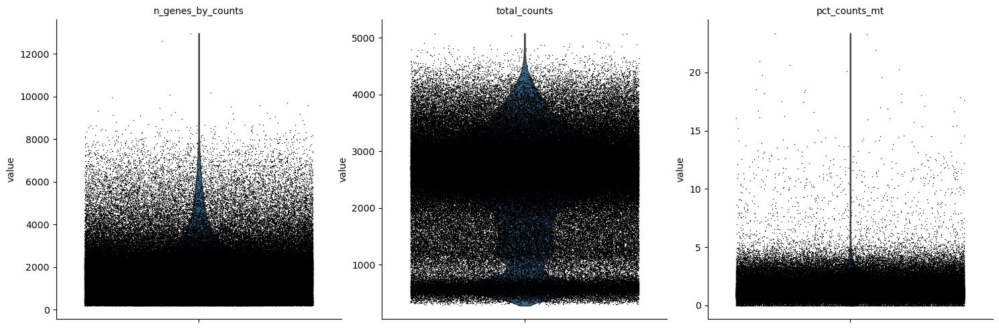

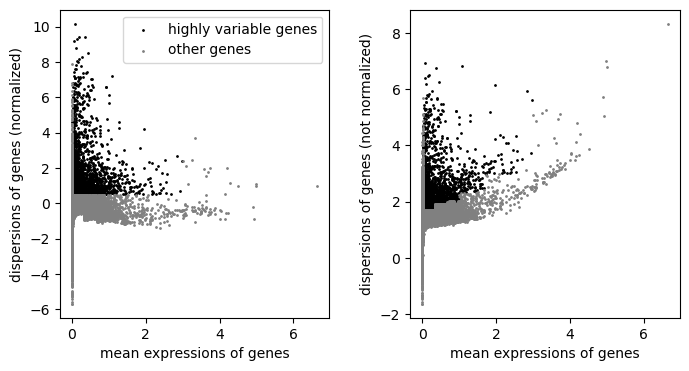

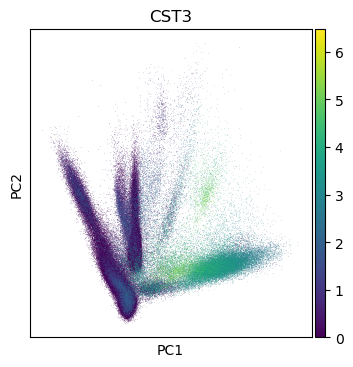

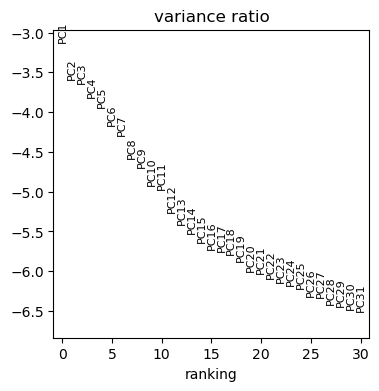

UMAP


/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


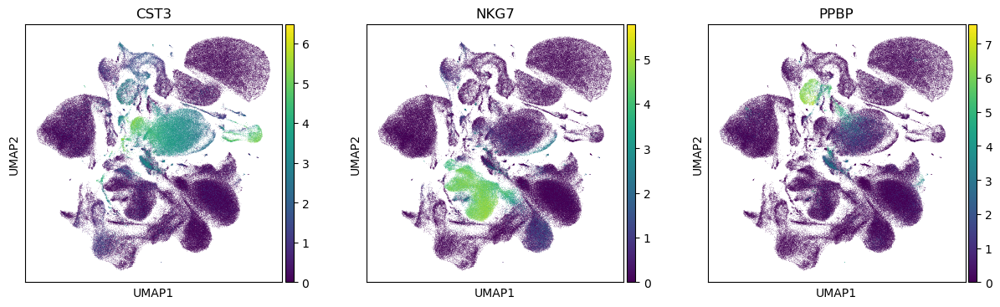

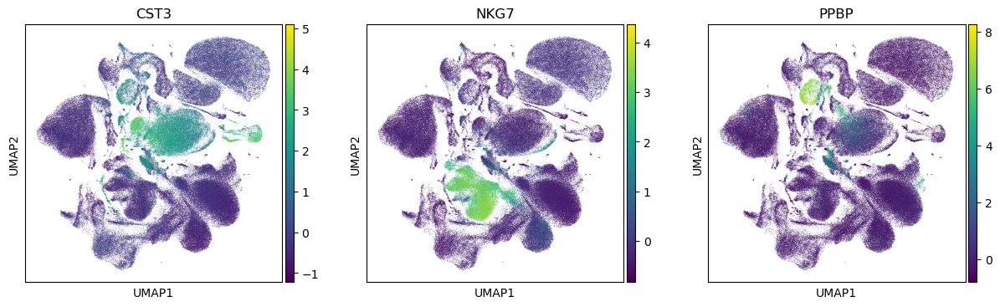

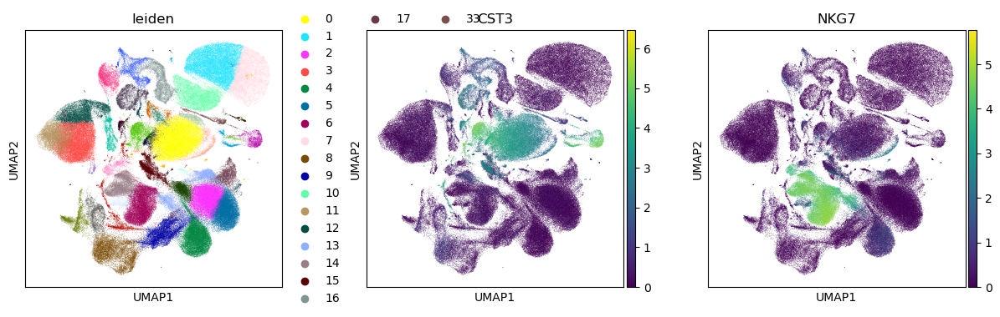

In [9]:

sc.pp.filter_cells(adata, min_genes=200)

sc.pp.filter_genes(adata, min_cells=3)

adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'

sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

adata = adata[adata.obs.n_genes_by_counts < 8000, :]
adata = adata[adata.obs.pct_counts_mt < 10, :]
adata.uns['log1p']["base"] = None

# sc.pp.normalize_total(adata, target_sum=1e4)

# sc.pp.log1p(adata)

adata.raw = adata

sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

sc.pl.highly_variable_genes(adata)

adata = adata[:, adata.var.highly_variable]

sc.pp.regress_out(adata, ['total_counts',  'pct_counts_mt'])

sc.pp.scale(adata, max_value=10)

sc.tl.pca(adata, svd_solver='arpack')

sc.pl.pca(adata, color='CST3')

sc.pl.pca_variance_ratio(adata, log=True)

adata.write_h5ad("../All_scanpyData/D2_scanpy_merge_rmdoubulet_log1p_PCA.h5ad")

print("UMAP")

sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)
sc.tl.umap(adata)

sc.pl.umap(adata, color=['CST3', 'NKG7', 'PPBP'])

sc.pl.umap(adata, color=['CST3', 'NKG7', 'PPBP'], use_raw=False)

sc.tl.leiden(adata)

sc.pl.umap(adata, color=['leiden', 'CST3', 'NKG7'])
adata.write_h5ad("../All_scanpyData/D2_scanpy_merge_rmdoubulet_UMAP2.h5ad")




In [10]:
adata1=sc.read_h5ad("../All_scanpyData/Data/Scanpy_merge_rmdoubulet_UMAP_label_lastCell.h5ad")

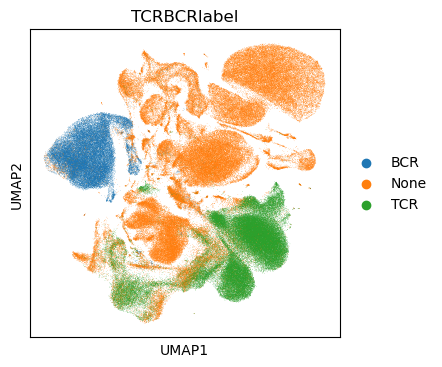

In [12]:
sc.pl.umap(adata,color=['TCRBCRlabel'])

Diff


/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: Da

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals_adj'] = pvals_adj[global_indices]
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: Da

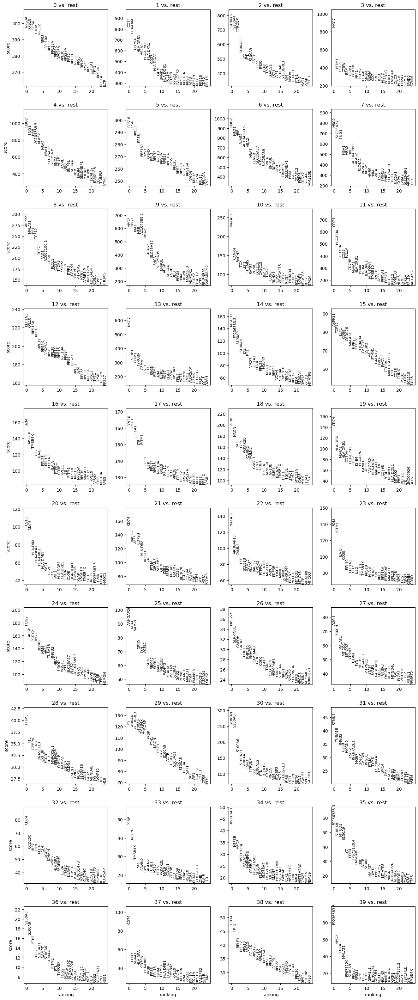

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: Da

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals_adj'] = pvals_adj[global_indices]
/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'logfoldchanges'] = np.log2(


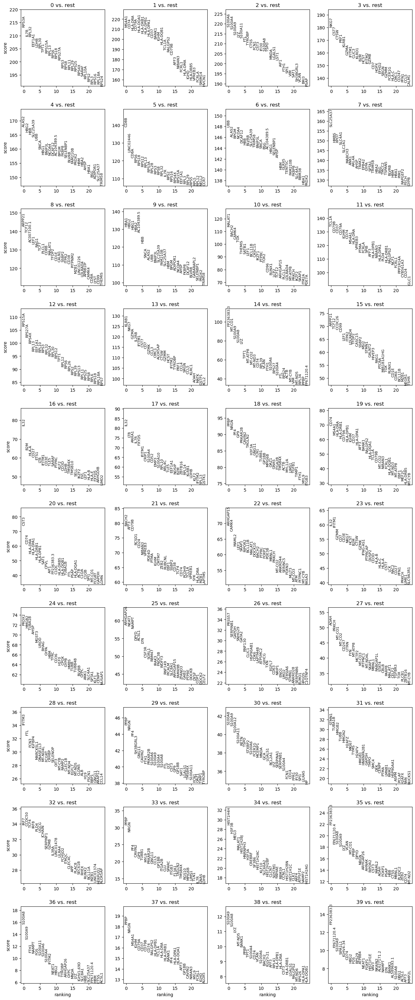

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


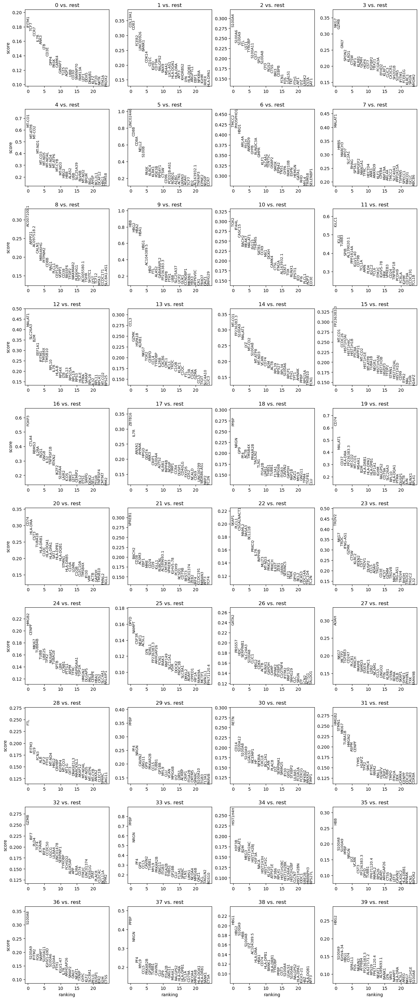

In [8]:
print("Diff")
adata.uns['log1p']["base"] = None
# Diff
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')

# Diff save
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
adata.write_h5ad("../All_scanpyData/D2_scanpy_merge_rmdoubulet_Diff_ttest.h5ad")
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
adata.write_h5ad("../All_scanpyData/D2_scanpy_merge_rmdoubulet_Diff_wilcoxon.h5ad")
sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
adata.write_h5ad("../All_scanpyData/D2_scanpy_merge_rmdoubulet_Diff_logreg.h5ad")

### Vis

In [10]:
adata1=sc.read_h5ad('../All_scanpyData/D2_scanpy_merge_rmdoubulet_UMAP2.h5ad')

In [32]:
adata.obs["Last_cell_type"]="NA"

In [33]:
adata.obs.update(adata1.obs[["Last_cell_type"]])

In [17]:
def create_palette(cell_types, colors):
    cell_type_colors = {}
    for i, cell_type in enumerate(cell_types):
        color = colors[i % len(colors)]
        cell_type_colors[cell_type] = color
    return cell_type_colors

colorname2=["#46A040" ,"#00AF99", "#FFC179" ,"#98D9E9" ,"#F6313E", "#FFA300", "#333366", "#FF5A00", "#663366","#FF6666",
"#8F1336", "#0081C9", "#001588", "#CC0033","#CC9966","#CC0033","#999933","#009966","#CCCC33","#CCFF99","#333399","#993333",
"#490C65", "#BA7FD0","#A6CEE3", "#1F78B4", "#DE77AE", "#B2DF8A", "#006D2C", "#868686", "#B5AD64","#9DA8E2","#91C392","#FF9900","#339966","#46A040" ,"#00AF99", "#FFC179" ,"#98D9E9" ,"#F6313E"]

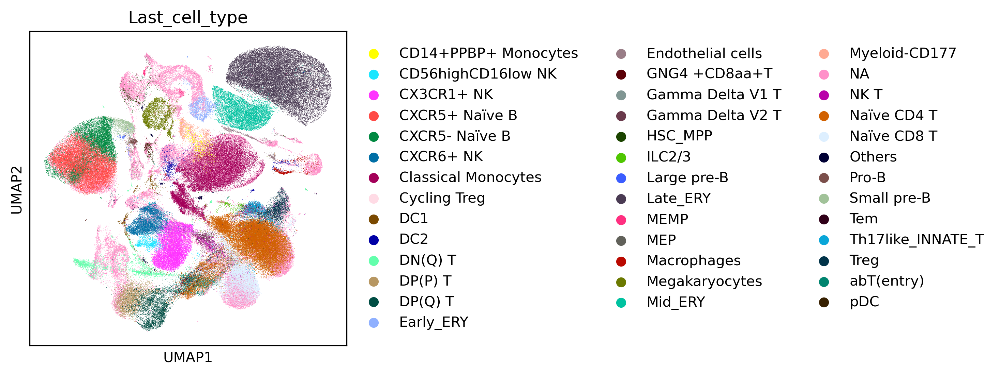

In [34]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color='Last_cell_type')

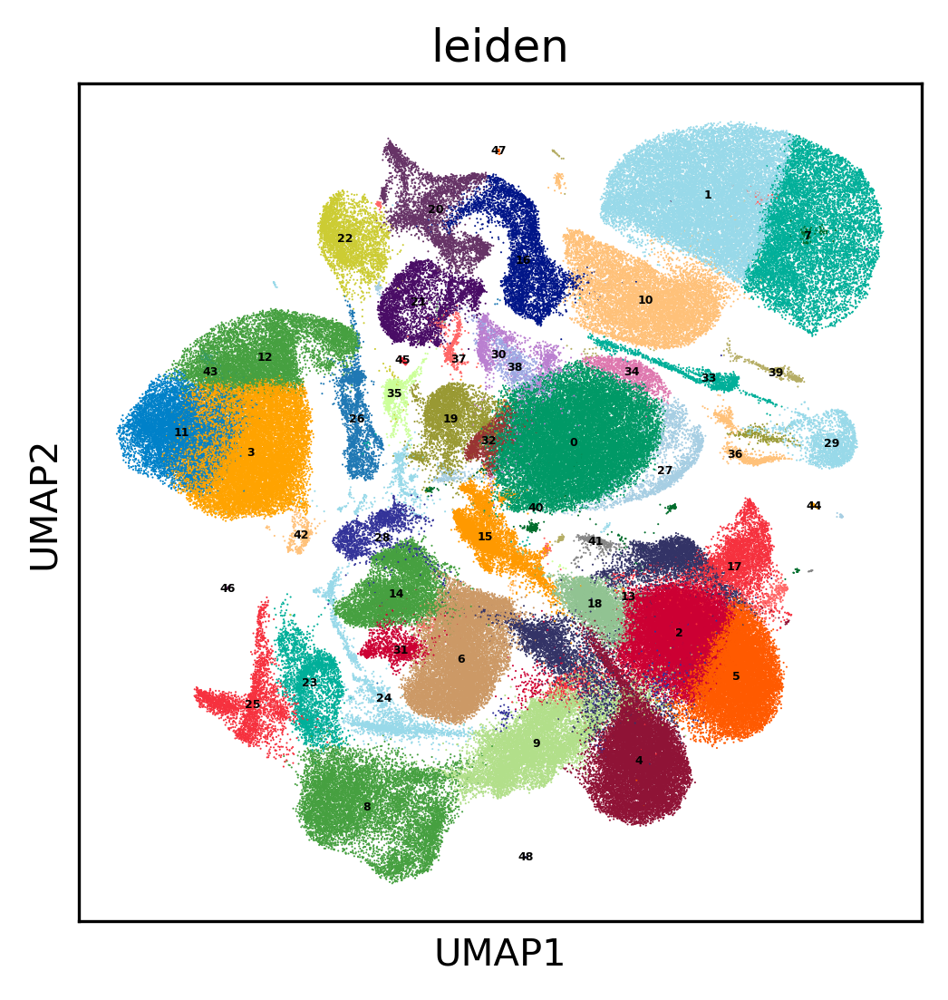

In [59]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color='leiden',legend_loc='on data',size=1,legend_fontsize=3)

In [ ]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color=[''],legend_loc='on data',size=1,legend_fontsize=2)

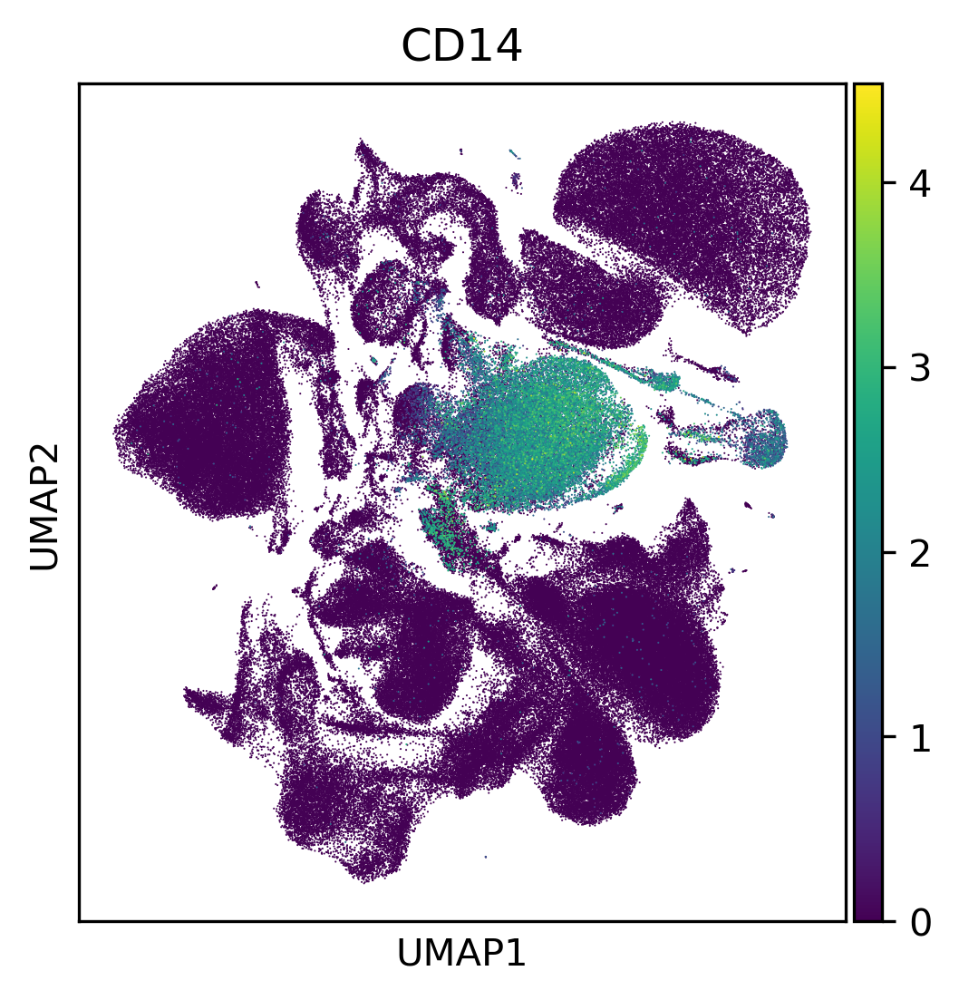

In [65]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color=['CD14'],legend_loc='on data',size=1,legend_fontsize=2)

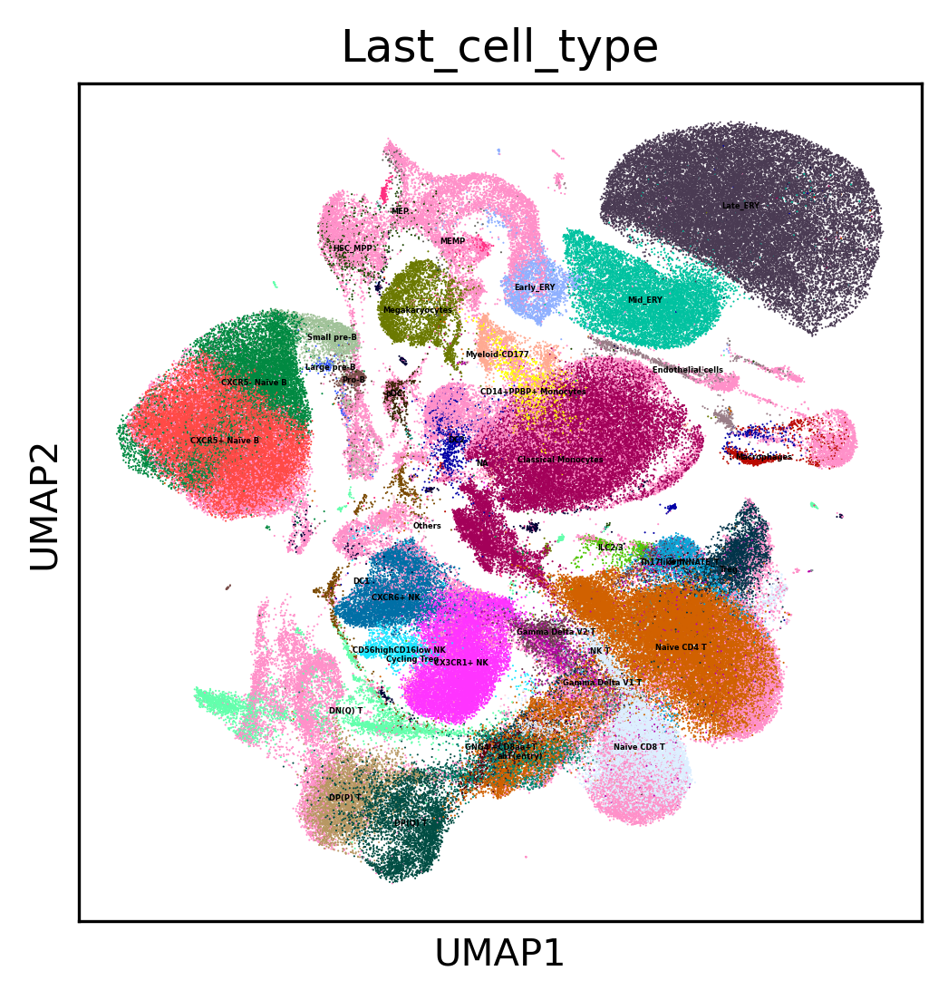

In [37]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color='Last_cell_type',legend_loc='on data',size=1,legend_fontsize=2)

In [ ]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color='Last_cell_type',legend_loc='on data',size=1,legend_fontsize=2)

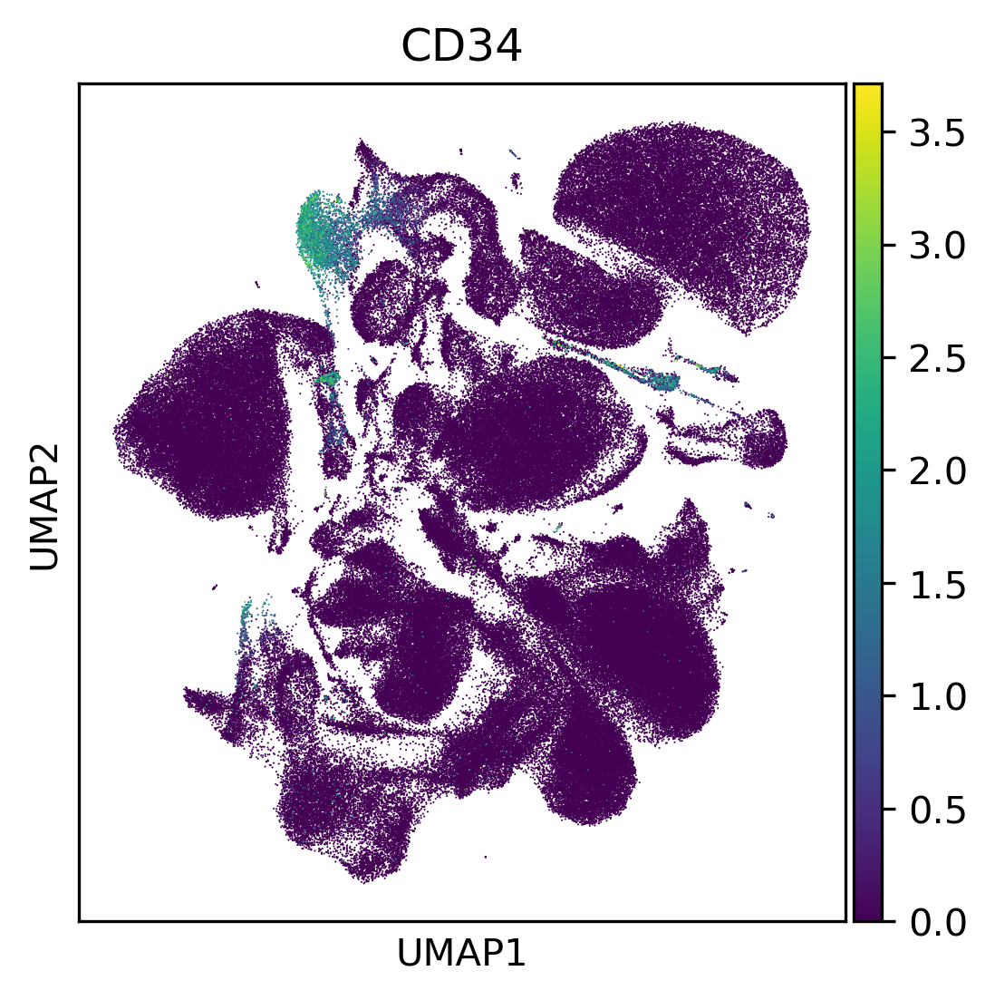

In [38]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color=['CD34'],legend_loc='on data',size=1,legend_fontsize=2)

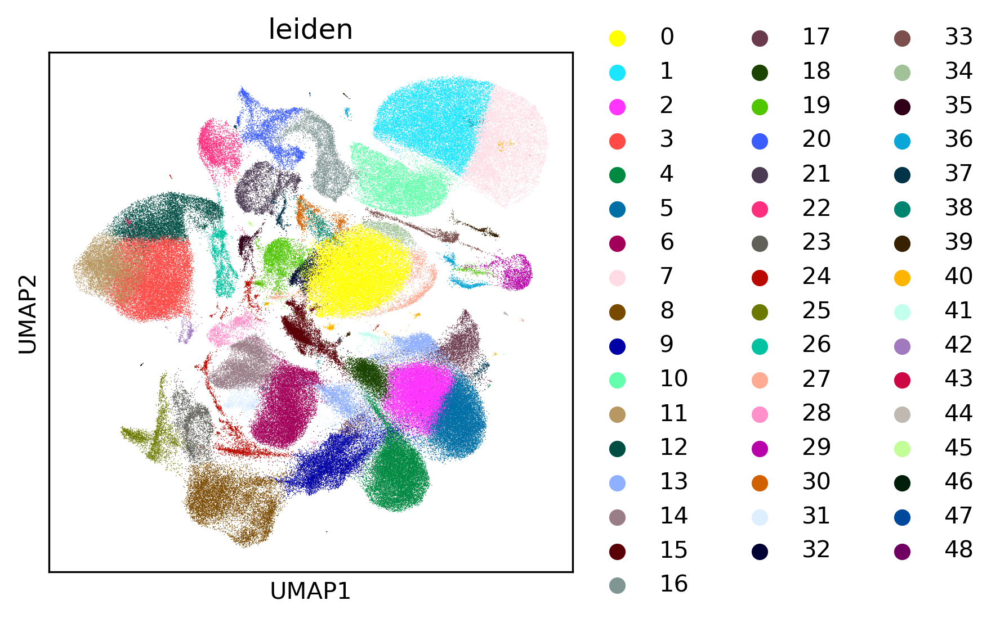

In [19]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color='leiden')

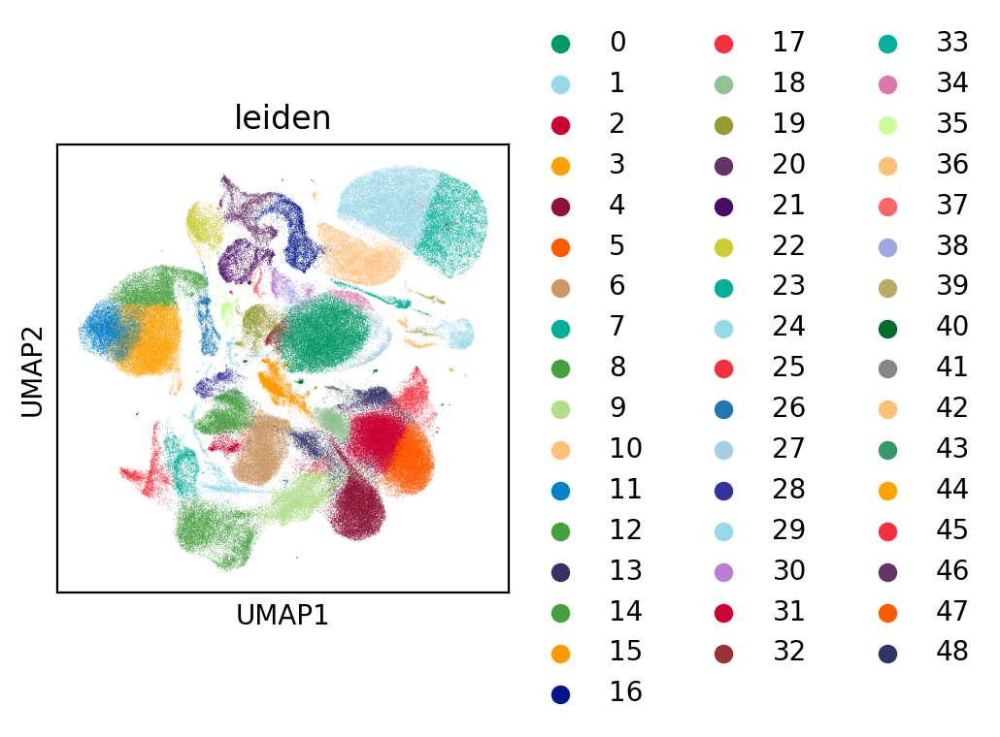

In [22]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [3, 3]
plt.rcParams['figure.dpi'] = 200
sc.pl.umap(adata, color='leiden',palette=create_palette(adata.obs["leiden"].unique(),colorname2), alpha=0.5,legend_fontweight="normal")

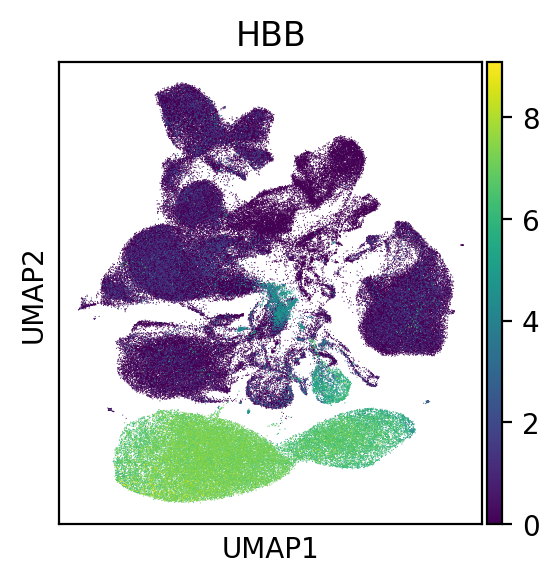

In [15]:
sc.pl.umap(adata1,color=['HBB'])

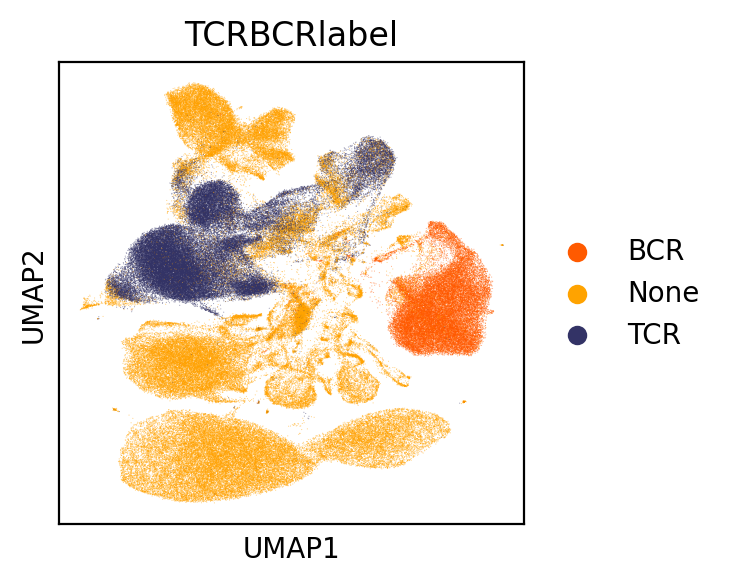

In [16]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [3, 3]
plt.rcParams['figure.dpi'] = 200
sc.pl.umap(adata1, color='TCRBCRlabel',palette=create_palette(adata1.obs["TCRBCRlabel"].unique(),colorname2[5:8]), alpha=0.5,legend_fontweight="normal")

In [48]:
adata.obs["majority_voting"].value_counts()

Tcm/Naive helper T cells                        53231
Naive B cells                                   34313
Classical monocytes                             30855
Erythrocytes                                    25071
Tcm/Naive cytotoxic T cells                     15777
CD16- NK cells                                  12847
Double-positive thymocytes                      12487
Late erythroid                                  11800
CD16+ NK cells                                  10805
Double-negative thymocytes                       4445
Mid erythroid                                    4398
Megakaryocytes/platelets                         3721
DC2                                              3377
HSC/MPP                                          2607
Kupffer cells                                    2282
Megakaryocyte-erythroid-mast cell progenitor     1943
Regulatory T cells                               1906
Non-classical monocytes                          1734
CD8a/b(entry)               

In [18]:
len(adata1.obs["majority_voting"].unique())

45

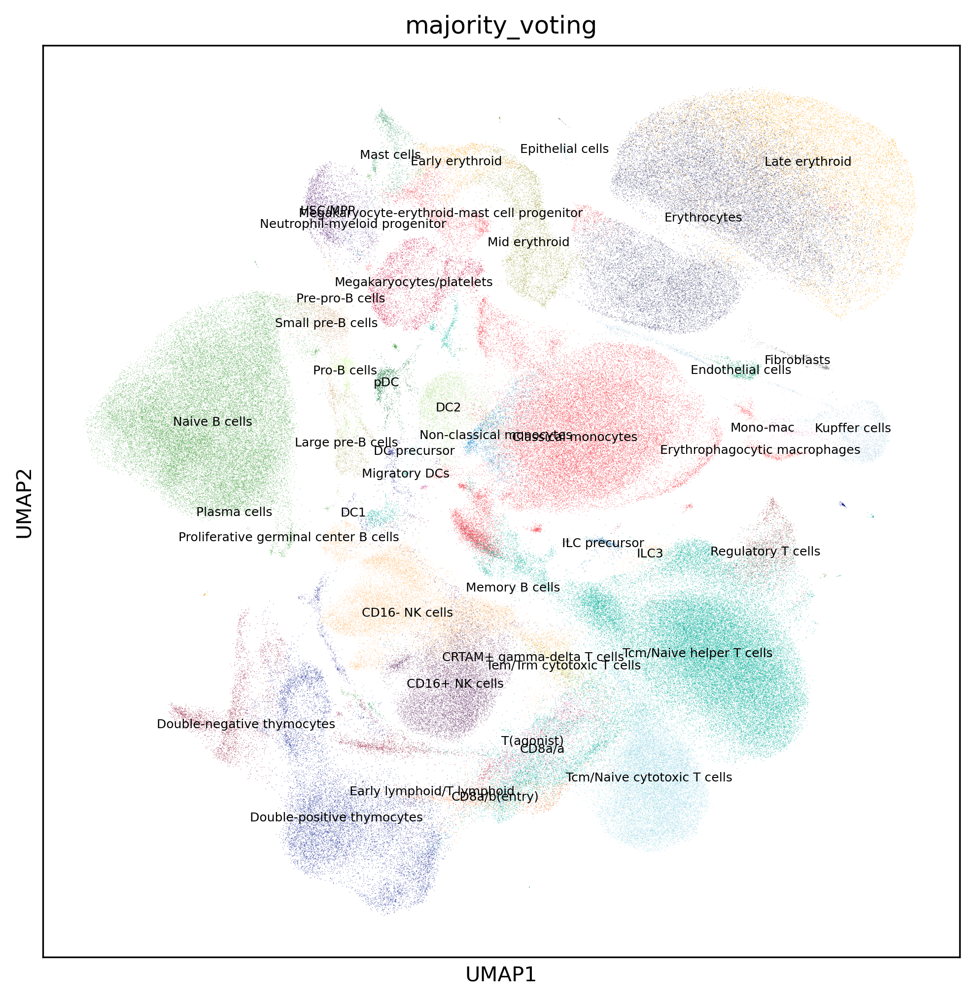

In [39]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color="majority_voting",palette=create_palette(adata1.obs["majority_voting"].unique(),colorname2), legend_loc='on data',legend_fontsize=6,alpha=0.5,legend_fontweight="normal")

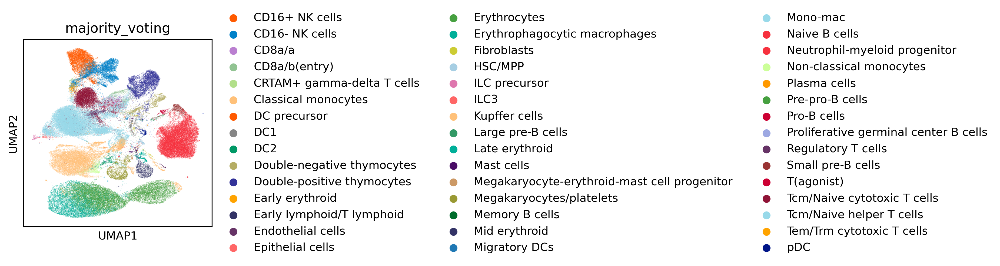

In [20]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [3, 3]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata1, color = [ "majority_voting"],palette=create_palette(adata1.obs["majority_voting"].unique(),colorname2), alpha=0.5, legend_fontweight="normal")


In [23]:
len(adata1.obs['AdjustedID'].unique())

32

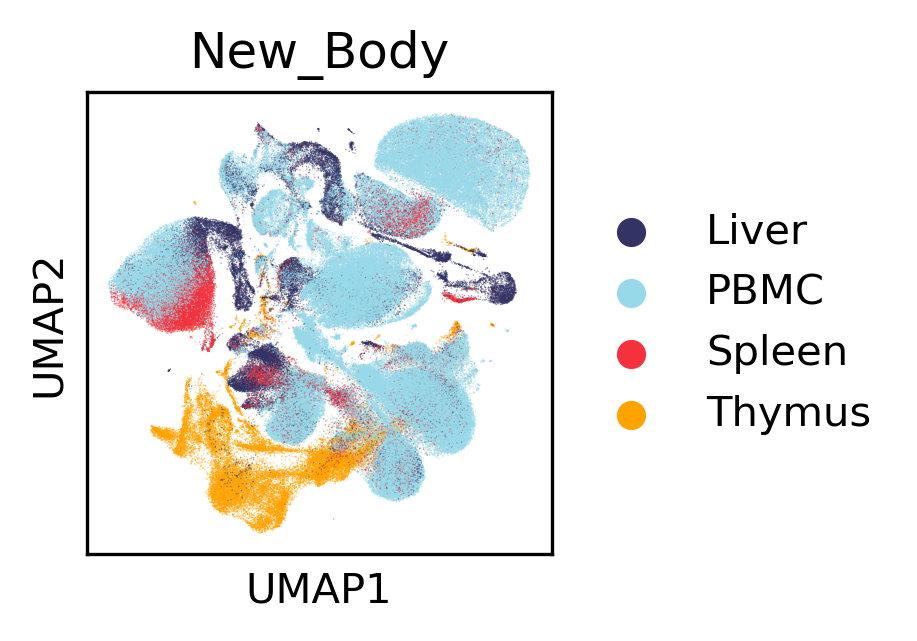

In [41]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams['figure.dpi'] = 300
sc.pl.umap(adata, color = [ "New_Body"],palette=create_palette(adata1.obs["New_Body"].unique(),colorname2[3:8]), alpha=0.5,legend_fontweight="normal")


In [42]:
def cluster_small_multiples(
    adata, clust_key, size=60, frameon=False, legend_loc=None, **kwargs
):
    tmp = adata.copy()

    for i, clust in enumerate(adata.obs[clust_key].cat.categories):
        tmp.obs[clust] = adata.obs[clust_key].isin([clust]).astype("category")
        tmp.uns[clust + "_colors"] = ["#d3d3d3", adata.uns[clust_key + "_colors"][i]]

    sc.pl.umap(
        tmp,
        groups=tmp.obs[clust].cat.categories[1:].values,
        color=adata.obs[clust_key].cat.categories.tolist(),
        size=size,
        frameon=frameon,
        legend_loc=legend_loc,
        **kwargs,
    )

In [3]:
adata1=sc.read_h5ad('/home/maolp/data5/Gaofeng_All_matrix/Allcount/All_scanpyData/Data/Scanpy_merge_rmdoubulet_UMAP_label_lastCell.h5ad')

In [4]:
adata1.obs['AdjustedID']=adata1.obs['AdjustedID'].astype('str')

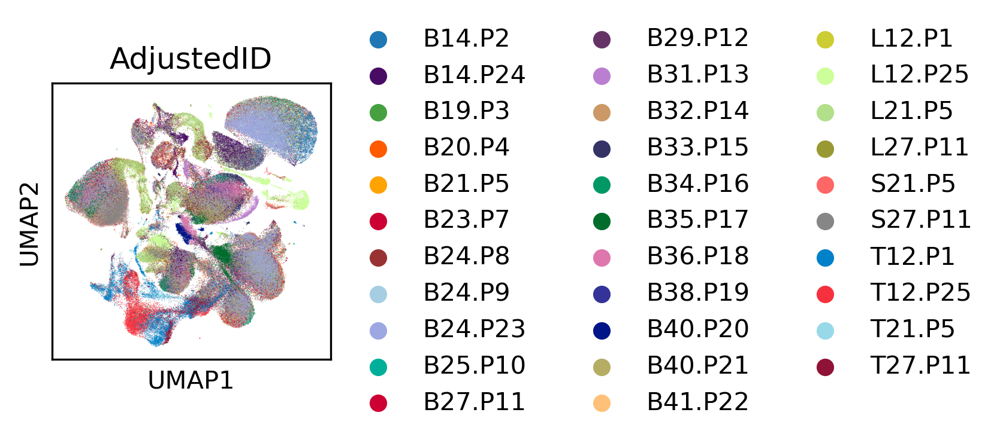

In [56]:
mkdir -p ../All_scanpyData/Data/

In [54]:
os.getcwd()

'/data5/maolp/Gaofeng_All_matrix/Allcount/All_h5'

In [57]:
adata.write_h5ad("../All_scanpyData/Data/Scanpy_merge_rmdoubulet_UMAP_label_lastCell.h5ad")

In [19]:
# plt.style.use('default')
# plt.rcParams['figure.figsize'] = [2, 2]
# plt.rcParams['figure.dpi'] = 300
# sc.pl.umap(adata1, color = [ "AdjustedID"],palette=create_palette(adata1.obs["AdjustedID"].unique(),colorname2), alpha=0.5,legend_fontweight="normal")


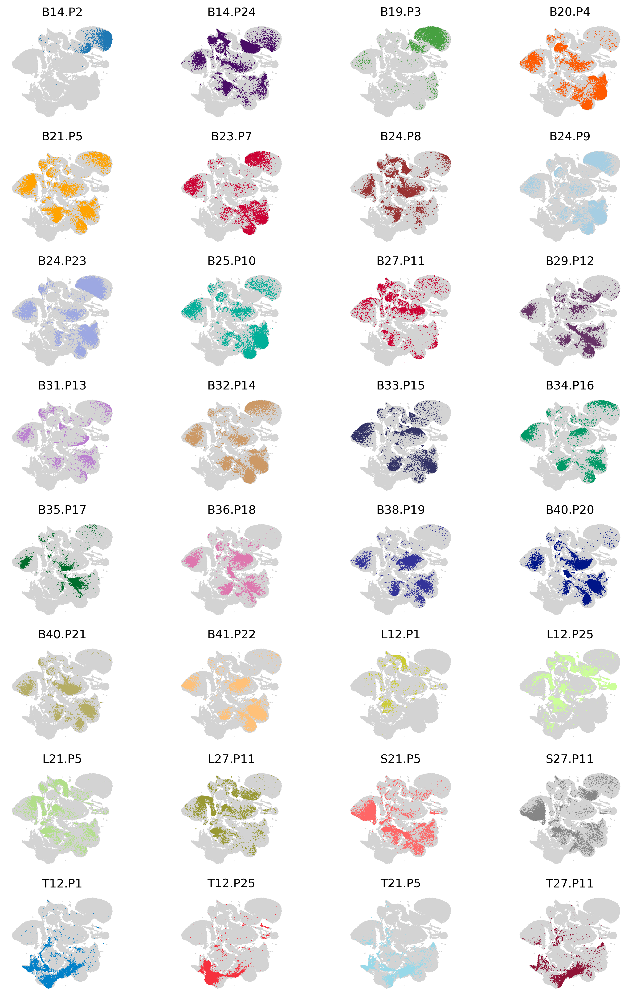

In [47]:
cluster_small_multiples(adata,'AdjustedID',size=2)